<a href="https://colab.research.google.com/github/caltunay/selfIsolation_refreshers/blob/main/ANN_People_Analytics_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install pandas_profiling==2.9

     |████████████████████████████████| 266kB 8.8MB/s 
     |████████████████████████████████| 604kB 15.4MB/s 
     |████████████████████████████████| 71kB 7.5MB/s 
     |████████████████████████████████| 71kB 7.9MB/s 
     |████████████████████████████████| 3.1MB 8.0MB/s 
     |████████████████████████████████| 296kB 37.4MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp36-none-any.whl size=27085 sha256=0795c6cad2a64deece6462f287a757f8afd934d16341095ba1a1ee2d756f3849
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
Successfully built htmlmin
  Found existing installation: tqdm 4.41.1
    Uninstalling tqdm-4.41.1:
      Successfully uninstalled tqdm-4.41.1
  Found existing installation: pandas-profiling 1.4.1
    Uninstalling pandas-profiling-1.4.1:
      Successfully uninstalled pandas-profiling-1.4.1


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport

%matplotlib inline

In [ ]:


df = pd.read_csv(data_path)
df.sample(5)

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
1251,30,No,Travel_Rarely,979,Sales,15,2,Marketing,1,1754,3,Male,94,2,3,Sales Executive,1,Divorced,7140,3088,2,Y,No,11,3,1,80,1,12,2,3,7,7,1,7
1285,46,No,Non-Travel,849,Sales,26,2,Life Sciences,1,1801,2,Male,98,2,2,Sales Executive,2,Single,7991,25166,8,Y,No,15,3,3,80,0,6,3,3,2,2,2,2
963,38,No,Travel_Rarely,1009,Sales,2,2,Life Sciences,1,1355,2,Female,31,3,2,Sales Executive,1,Divorced,6893,19461,3,Y,No,15,3,4,80,1,11,3,3,7,7,1,7
1052,30,No,Non-Travel,990,Research & Development,7,3,Technical Degree,1,1482,3,Male,64,3,1,Research Scientist,3,Divorced,1274,7152,1,Y,No,13,3,2,80,2,1,2,2,1,0,0,0
1200,44,No,Travel_Rarely,528,Human Resources,1,3,Life Sciences,1,1683,3,Female,44,3,1,Human Resources,4,Divorced,3195,4167,4,Y,Yes,18,3,1,80,3,8,2,3,2,2,2,2


In [ ]:
report = ProfileReport(df)
report

Summarize dataset:   0%|          | 0/49 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Attrition (yhat) and Overtime cols are binary string (Y/N). Convert to numeric.




In [ ]:
emp_df = df.copy()

In [ ]:
binary_cols = 'OverTime Attrition'.split()

for col in binary_cols:
    emp_df[col] = emp_df[col].apply(lambda x:1 if x == 'Yes' else 0)

emp_df.sample(3)

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,Gender,HourlyRate,JobInvolvement,JobLevel,JobRole,JobSatisfaction,MaritalStatus,MonthlyIncome,MonthlyRate,NumCompaniesWorked,Over18,OverTime,PercentSalaryHike,PerformanceRating,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
13,34,0,Travel_Rarely,1346,Research & Development,19,2,Medical,1,18,2,Male,93,3,1,Laboratory Technician,4,Divorced,2661,8758,0,Y,0,11,3,3,80,1,3,2,3,2,2,1,2
1073,28,0,Travel_Rarely,1083,Research & Development,29,1,Life Sciences,1,1514,3,Male,96,1,2,Manufacturing Director,2,Married,6549,3173,1,Y,0,14,3,2,80,2,8,2,2,8,6,1,7
287,38,0,Travel_Rarely,688,Research & Development,23,4,Life Sciences,1,393,4,Male,82,3,2,Healthcare Representative,4,Divorced,5745,18899,9,Y,0,14,3,2,80,1,10,2,3,2,2,1,2


# Drop StandardHours, EmployeeCount, Over18, EmployeeNumber

In [ ]:
emp_df.drop(labels = 'EmployeeCount Over18 StandardHours EmployeeNumber'.split(), axis = 1, inplace = True)

In [ ]:
emp_df.groupby('Attrition').describe().T

Attrition                             0           1
Age                  count  1233.000000  237.000000
                     mean     37.561233   33.607595
                     std       8.888360    9.689350
                     min      18.000000   18.000000
                     25%      31.000000   28.000000
...                                 ...         ...
YearsWithCurrManager min       0.000000    0.000000
                     25%       2.000000    0.000000
                     50%       3.000000    2.000000
                     75%       7.000000    5.000000
                     max      17.000000   14.000000

[192 rows x 2 columns]

In [ ]:
emp_left = emp_df[emp_df['Attrition'] == 1]
emp_stayed = emp_df[emp_df['Attrition'] == 0]

In [ ]:
print(f'Employees that left: {emp_left.shape[0]}, \nEmployees that left (ratio): {str(round(emp_left.shape[0] / emp_df.shape[0], 3)*100)}% \n\n Employees that stayed: {emp_stayed.shape[0]}, \nEmployees that stayed (ratio): {str(round(emp_stayed.shape[0] / emp_df.shape[0], 3)*100)}%')

# str(round(emp_left.shape[0] / emp_df.shape[0], 3)*100)

Employees that left: 237, 
Employees that left (ratio): 16.1% 

 Employees that stayed: 1233, 
Employees that stayed (ratio): 83.89999999999999%


In [ ]:
# viz left v stayed initial stats
left_v_stayed_frequentist_approach = pd.merge(left = emp_left.describe().T['mean'], right = emp_stayed.describe().T['mean'], left_index = True, right_index = True, suffixes = ('_left','_stayed') )
left_v_stayed_frequentist_approach

,mean_left,mean_stayed
Age,33.607595,37.561233
Attrition,1.000000,0.000000
DailyRate,750.362869,812.504461
DistanceFromHome,10.632911,8.915653
Education,2.839662,2.927007
EnvironmentSatisfaction,2.464135,2.771290
HourlyRate,65.573840,65.952149
JobInvolvement,2.518987,2.770479
JobLevel,1.637131,2.145985
JobSatisfaction,2.468354,2.778589


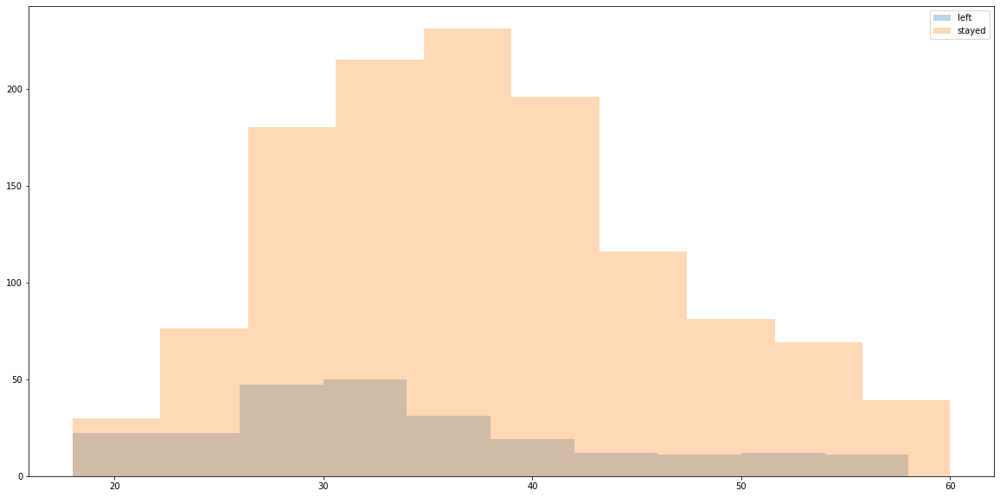

In [ ]:
plt.figure(figsize = (20,10))
plt.hist(emp_left['Age'], bins = 10, label = 'left', alpha = .3)
plt.hist(emp_stayed['Age'], bins = 10, label = 'stayed', alpha = .3)
plt.legend(loc = 'upper right', )
plt.show()

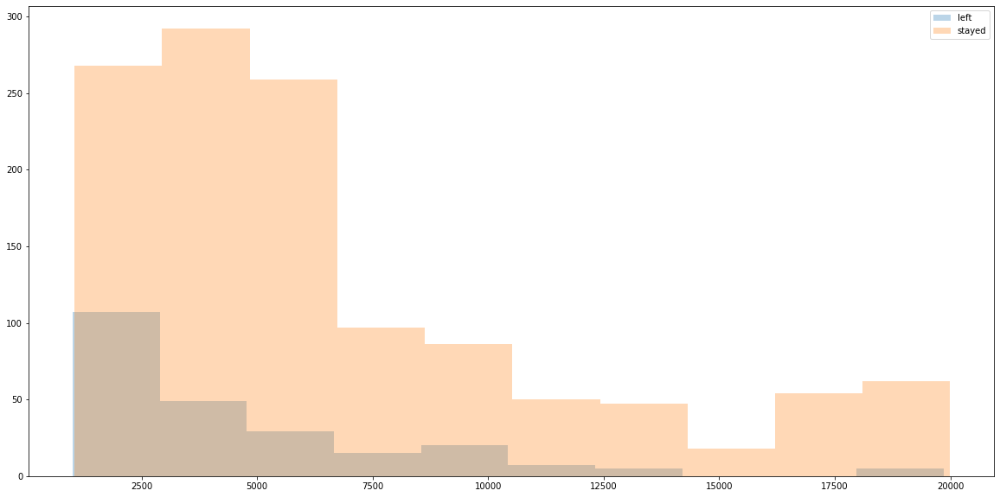

In [ ]:
plt.figure(figsize = (20,10))
plt.hist(emp_left['MonthlyIncome'], bins = 10, label = 'left', alpha = .3)
plt.hist(emp_stayed['MonthlyIncome'], bins = 10, label = 'stayed', alpha = .3)
plt.legend(loc = 'upper right', )
plt.show()

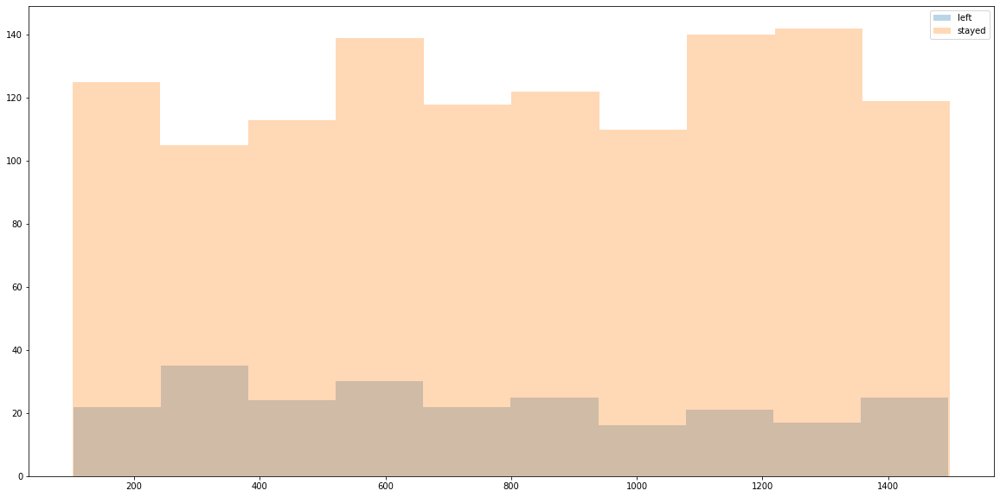

In [ ]:
plt.figure(figsize = (20,10))
plt.hist(emp_left['DailyRate'], bins = 10, label = 'left', alpha = .3)
plt.hist(emp_stayed['DailyRate'], bins = 10, label = 'stayed', alpha = .3)
plt.legend(loc = 'upper right', )
plt.show()

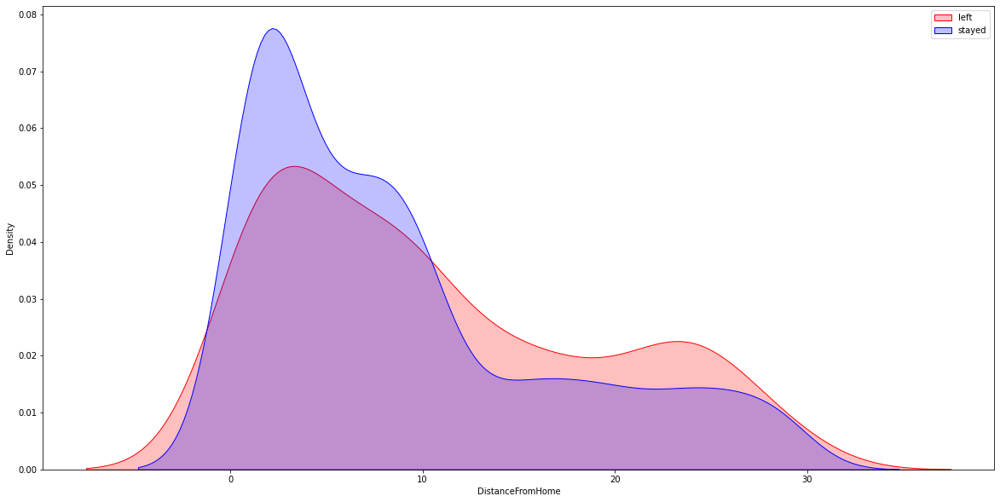

In [ ]:
plt.figure(figsize = (20,10))

sns.kdeplot(emp_left['DistanceFromHome'], label = 'left', color = 'r', shade = True)
sns.kdeplot(emp_stayed['DistanceFromHome'], label = 'stayed', color = 'b', shade = True)
plt.legend(loc = 'upper right')
plt.show()

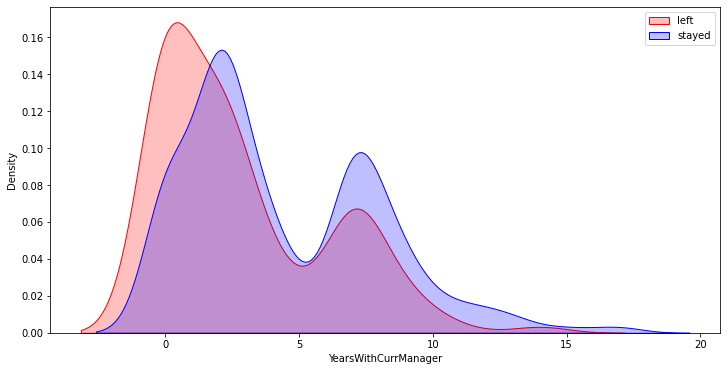

In [ ]:
plt.figure(figsize = (12,6))

sns.kdeplot(emp_left['YearsWithCurrManager'], shade = True, label = 'left', color = 'r')
sns.kdeplot(emp_stayed['YearsWithCurrManager'], shade = True, label = 'stayed', color = 'b')
plt.legend(loc = 'upper right')
plt.show()

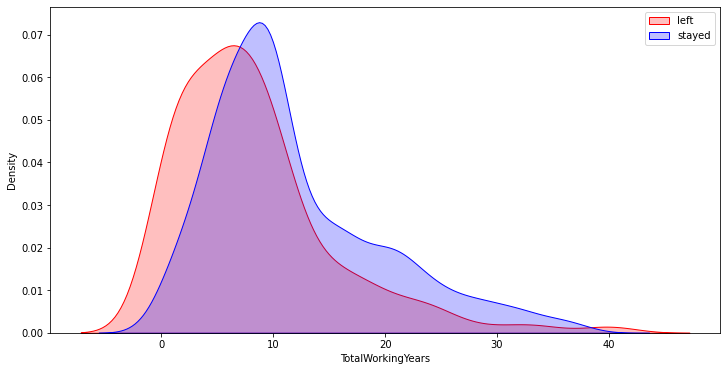

In [ ]:
plt.figure(figsize = (12,6))

sns.kdeplot(emp_left['TotalWorkingYears'], shade = True, label = 'left', color = 'r')
sns.kdeplot(emp_stayed['TotalWorkingYears'], shade = True, label = 'stayed', color = 'b')
plt.legend(loc = 'upper right')
plt.show()

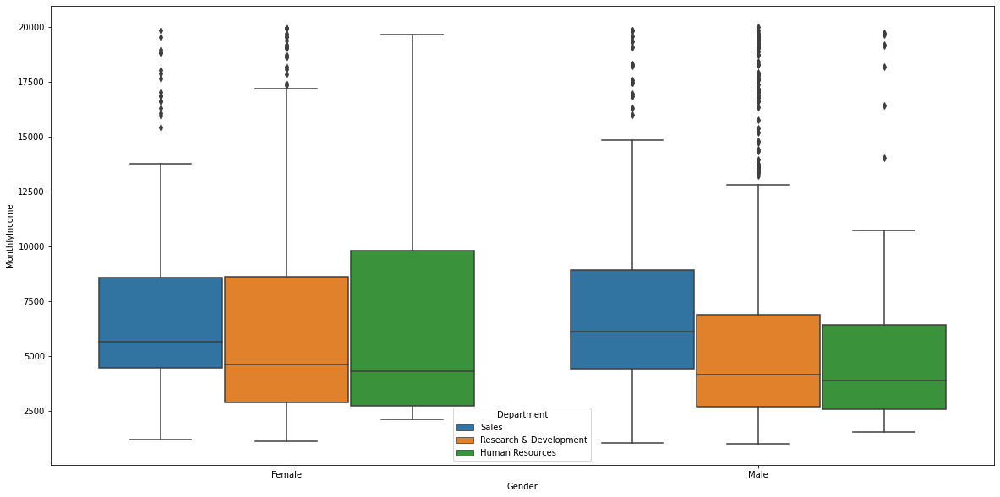

In [ ]:
# boxplot for gender v monthly income
plt.figure(figsize = (20,10))

sns.boxplot(data = emp_df, x = 'Gender', y = 'MonthlyIncome', hue = 'Department')
plt.show()

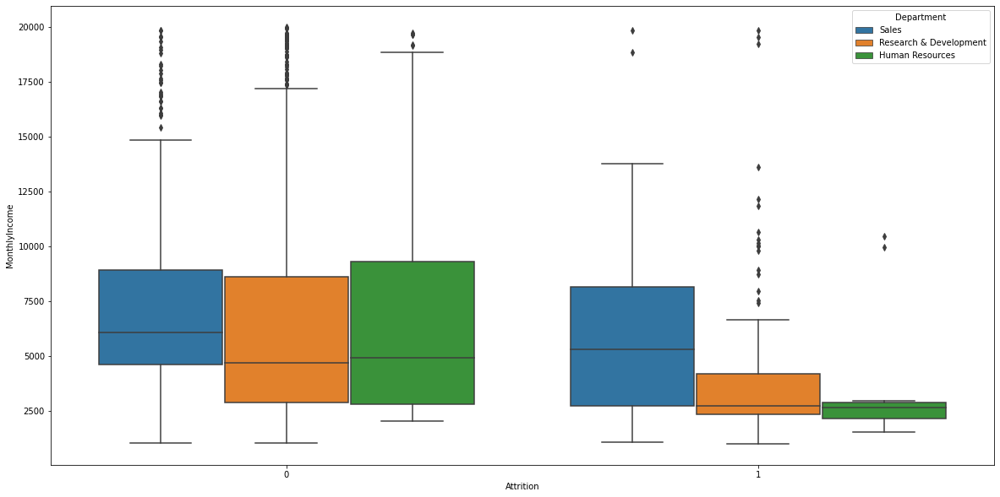

In [ ]:
# boxplot for gender v monthly income
plt.figure(figsize = (20,10))

sns.boxplot(data = emp_df, x = 'Attrition', y = 'MonthlyIncome', hue = 'Department')
plt.show()

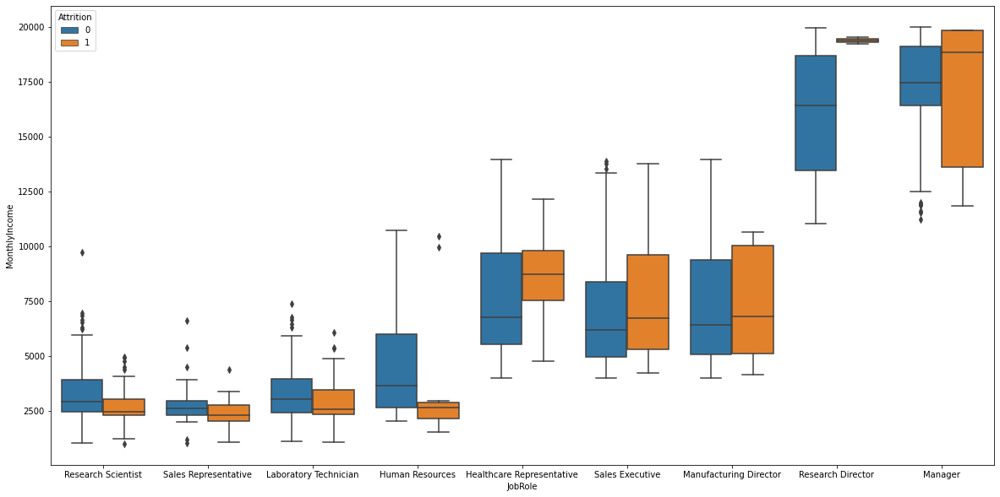

In [ ]:
# boxplot for gender v monthly income
plt.figure(figsize = (20,10))

sns.boxplot(data = emp_df.sort_values(by = 'MonthlyIncome'), x = 'JobRole', y = 'MonthlyIncome', hue = 'Attrition')
plt.show()

Data Cleaning & Preprocessing

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder

In [ ]:
emp_df.dtypes

Age                          int64
Attrition                    int64
BusinessTravel              object
DailyRate                    int64
Department                  object
DistanceFromHome             int64
Education                    int64
EducationField              object
EnvironmentSatisfaction      int64
Gender                      object
HourlyRate                   int64
JobInvolvement               int64
JobLevel                     int64
JobRole                     object
JobSatisfaction              int64
MaritalStatus               object
MonthlyIncome                int64
MonthlyRate                  int64
NumCompaniesWorked           int64
OverTime                     int64
PercentSalaryHike            int64
PerformanceRating            int64
RelationshipSatisfaction     int64
StockOptionLevel             int64
TotalWorkingYears            int64
TrainingTimesLastYear        int64
WorkLifeBalance              int64
YearsAtCompany               int64
YearsInCurrentRole  

In [ ]:
x_cat = emp_df.select_dtypes(include = 'object')

In [ ]:
encoder = OneHotEncoder()

In [ ]:
encoder.fit_transform(x_cat).toarray().shape

(1470, 26)

In [ ]:
x_cats = encoder.fit_transform(x_cat).toarray()    

In [ ]:
x_nums = emp_df.select_dtypes(include = 'number').drop(columns = ['Attrition'])

In [ ]:
x_all = pd.concat([pd.DataFrame(x_cats), x_nums], axis = 1)

In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
scaler = MinMaxScaler()
x_scaled = scaler.fit_transform(x_all)
x_scaled

array([[0.        , 0.        , 1.        , ..., 0.22222222, 0.        ,
        0.29411765],
       [0.        , 1.        , 0.        , ..., 0.38888889, 0.06666667,
        0.41176471],
       [0.        , 0.        , 1.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 1.        , ..., 0.11111111, 0.        ,
        0.17647059],
       [0.        , 1.        , 0.        , ..., 0.33333333, 0.        ,
        0.47058824],
       [0.        , 0.        , 1.        , ..., 0.16666667, 0.06666667,
        0.11764706]])

In [ ]:
y = emp_df['Attrition'].to_numpy()
y

array([1, 0, 1, ..., 0, 0, 0])

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(x_scaled, y)

print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(1102, 50) (368, 50) (1102,) (368,)


In [ ]:
logistic_model = LogisticRegression()

logistic_model.fit(x_train, y_train)
lm_preds = logistic_model.predict(x_test)
lm_preds

array([0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0,

In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report

In [ ]:
lm_acc = accuracy_score(y_test, lm_preds)
print(f'Accuracy of model is {str(round(lm_acc,3)*100)}%')

Accuracy of model is 88.0%


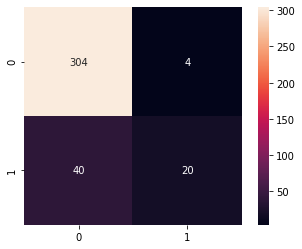

In [ ]:
lm_c_matrix = confusion_matrix(y_test, lm_preds)

sns.heatmap(lm_c_matrix, annot = True, square = True, fmt = '')

In [ ]:
lm_rep = classification_report(y_test, lm_preds)
print(lm_rep)

              precision    recall  f1-score   support

           0       0.88      0.99      0.93       308
           1       0.83      0.33      0.48        60

    accuracy                           0.88       368
   macro avg       0.86      0.66      0.70       368
weighted avg       0.88      0.88      0.86       368



In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
rfc = RandomForestClassifier()
rfc.fit(x_train, y_train)
rfc_preds = rfc.predict(x_test)
rfc_preds

array([0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

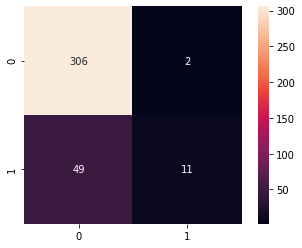

In [ ]:
rfc_c_matrix = confusion_matrix(y_test, rfc_preds)

sns.heatmap(rfc_c_matrix, square = True, annot = True, fmt = '')

In [ ]:
from keras.layers import Dense
from keras.models import Sequential
from keras.callbacks import EarlyStopping

In [ ]:
ann_model = Sequential()

ann_model.add(Dense(units = 1000, activation = 'relu', input_shape = x_train.shape[1:]))
ann_model.add(Dense(units = 1000, activation = 'relu'))
ann_model.add(Dense(units = 1000, activation = 'relu'))
ann_model.add(Dense(units = 1000, activation = 'relu'))
ann_model.add(Dense(units = 1, activation = 'sigmoid'))


In [ ]:
ann_model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_5 (Dense)              (None, 1000)              51000     
_________________________________________________________________
dense_6 (Dense)              (None, 1000)              1001000   
_________________________________________________________________
dense_7 (Dense)              (None, 1000)              1001000   
_________________________________________________________________
dense_8 (Dense)              (None, 1000)              1001000   
_________________________________________________________________
dense_9 (Dense)              (None, 1)                 1001      
Total params: 3,055,001
Trainable params: 3,055,001
Non-trainable params: 0
_________________________________________________________________


In [ ]:
stopper = EarlyStopping(monitor = 'val_accuracy', patience = 15)

In [ ]:
ann_model.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])
hist = ann_model.fit(x_train, y_train, epochs = 1000, batch_size = 50, validation_split = .2, callbacks = [stopper])

Epoch 1/1000
18/18 [==============================] - 2s 60ms/step - loss: 0.5170 - accuracy: 0.8074 - val_loss: 0.4083 - val_accuracy: 0.8371
Epoch 2/1000
18/18 [==============================] - 1s 50ms/step - loss: 0.4107 - accuracy: 0.8315 - val_loss: 0.3609 - val_accuracy: 0.8371
Epoch 3/1000
18/18 [==============================] - 1s 51ms/step - loss: 0.3516 - accuracy: 0.8462 - val_loss: 0.3831 - val_accuracy: 0.8507
Epoch 4/1000
18/18 [==============================] - 1s 51ms/step - loss: 0.2968 - accuracy: 0.8678 - val_loss: 0.3145 - val_accuracy: 0.8688
Epoch 5/1000
18/18 [==============================] - 1s 50ms/step - loss: 0.2494 - accuracy: 0.9020 - val_loss: 0.3471 - val_accuracy: 0.8778
Epoch 6/1000
18/18 [==============================] - 1s 50ms/step - loss: 0.1597 - accuracy: 0.9509 - val_loss: 0.3897 - val_accuracy: 0.8688
Epoch 7/1000
18/18 [==============================] - 1s 49ms/step - loss: 0.1667 - accuracy: 0.9392 - val_loss: 0.3827 - val_accuracy: 0.8643

In [ ]:
hist.history.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

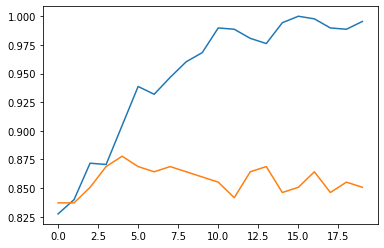

In [ ]:

plt.plot(hist.history['accuracy'])
plt.plot(hist.history['val_accuracy'])

plt.show()

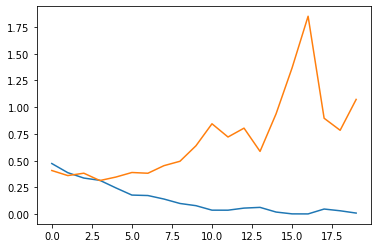

In [ ]:

plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])

plt.show()